In [106]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, fixed, IntSlider, widgets, Play, IntRangeSlider

In [7]:
f = np.load("D:/suite2p/plane0/F.npy", allow_pickle = True)
f.shape

(447, 2250)

## neuropil data 

In [18]:
neuropil = np.load("D:/suite2p/plane0/Fneu.npy", allow_pickle = True)
neuropil.shape

(447, 2250)

In [20]:
spikes = np.load("D:/suite2p/plane0/spks.npy", allow_pickle =True)
spikes.shape

(447, 2250)

In [22]:
stats = np.load("D:/suite2p/plane0/stat.npy", allow_pickle = True)
stats.shape

(447,)

In [28]:
ops = np.load("D:/suite2p/plane0/ops.npy", allow_pickle = True)
ops = ops.item()
ops.keys()

dict_keys(['look_one_level_down', 'fast_disk', 'delete_bin', 'mesoscan', 'bruker', 'h5py', 'h5py_key', 'save_path0', 'save_folder', 'subfolders', 'move_bin', 'nplanes', 'nchannels', 'functional_chan', 'tau', 'fs', 'force_sktiff', 'frames_include', 'multiplane_parallel', 'ignore_flyback', 'preclassify', 'save_mat', 'save_NWB', 'combined', 'aspect', 'do_bidiphase', 'bidiphase', 'bidi_corrected', 'do_registration', 'two_step_registration', 'keep_movie_raw', 'nimg_init', 'batch_size', 'maxregshift', 'align_by_chan', 'reg_tif', 'reg_tif_chan2', 'subpixel', 'smooth_sigma_time', 'smooth_sigma', 'th_badframes', 'norm_frames', 'force_refImg', 'pad_fft', 'nonrigid', 'block_size', 'snr_thresh', 'maxregshiftNR', '1Preg', 'spatial_hp', 'spatial_hp_reg', 'spatial_hp_detect', 'pre_smooth', 'spatial_taper', 'roidetect', 'spikedetect', 'anatomical_only', 'cellprob_threshold', 'flow_threshold', 'sparse_mode', 'diameter', 'spatial_scale', 'connected', 'nbinned', 'max_iterations', 'threshold_scaling', 'ma

In [29]:
iscell =np.load("D:/suite2p/plane0/iscell.npy", allow_pickle = True)
iscell.shape

(447, 2)

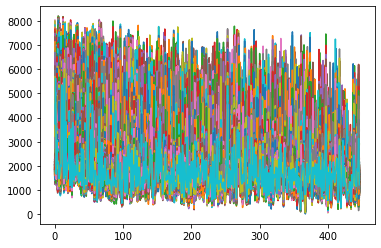

In [10]:
plt.plot(f);

In [11]:
f[0:5]

array([[2429.276 , 2252.6587, 1757.9232, ..., 2710.7178, 3235.0308,
        3742.2686],
       [2358.6738, 2474.8667, 2250.2327, ..., 4521.777 , 4648.652 ,
        5632.198 ],
       [2164.9067, 2214.087 , 2060.1477, ..., 1670.242 , 1685.4705,
        1671.8896],
       [3889.5771, 3817.8188, 3060.7153, ..., 2691.59  , 2846.6907,
        3054.7944],
       [1787.3519, 1660.5934, 1553.7773, ..., 1472.0242, 1899.6166,
        2101.6177]], dtype=float32)

In [12]:
f[0]

array([2429.276 , 2252.6587, 1757.9232, ..., 2710.7178, 3235.0308,
       3742.2686], dtype=float32)

### plot fluorescence intensity for each roi by frame

In [13]:
f[0]

array([2429.276 , 2252.6587, 1757.9232, ..., 2710.7178, 3235.0308,
       3742.2686], dtype=float32)

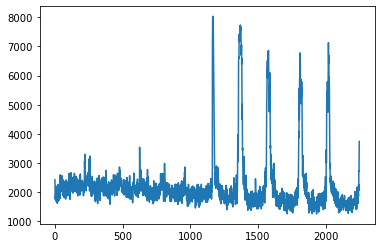

In [14]:
plt.plot(f[0])

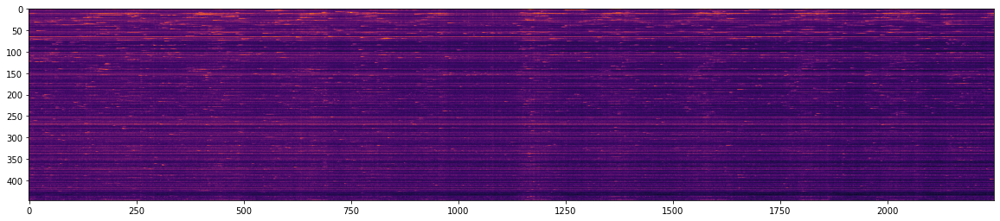

In [31]:
plt.figure(figsize=(20,5))
plt.imshow(f,cmap="inferno")

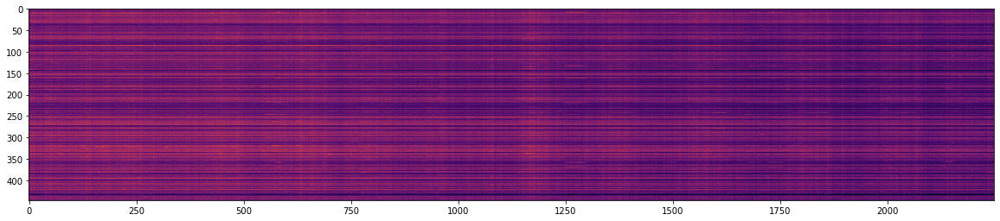

In [32]:
plt.figure(figsize=(20,5))
plt.imshow(neuropil,cmap="inferno")

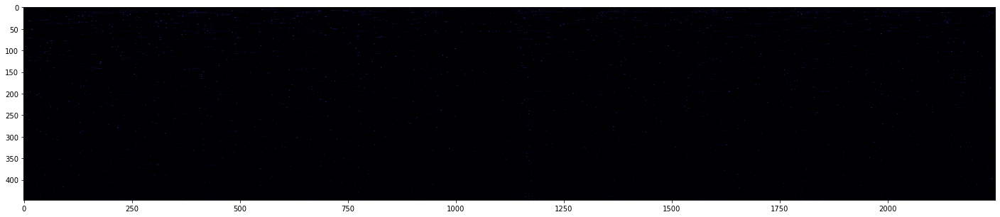

In [39]:
plt.figure(figsize=(30,5))
plt.imshow(spikes,cmap="inferno")

In [34]:
spikes.shape

(447, 2250)

In [36]:
np.amin(spikes)

0.0

In [37]:
np.amax(spikes)


5249.437

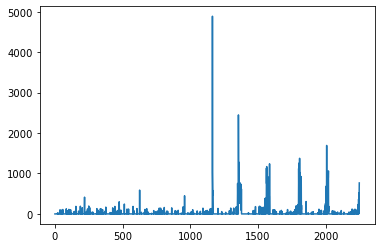

In [38]:
plt.plot(spikes[0])

In [40]:
iscell.shape

(447, 2)

In [41]:
type(iscell)

numpy.ndarray

In [60]:
np.sum(iscell,axis=0)

array([ 58.      , 180.628865])

In [55]:
index = iscell[:,0].astype(bool)

In [63]:
nice_cells =f[index]

In [77]:
threshold = 0.8
type([x[0] for x in iscell if x[1]> threshold])

list

In [89]:
nice_cells2 = f[np.where(iscell[:,0]==1 and iscell[:,1] > threshold)]

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

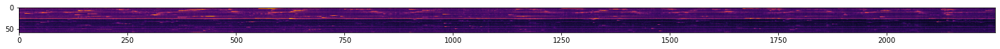

In [66]:
plt.figure(figsize=(25,15))
plt.imshow(nice_cells,cmap="inferno")

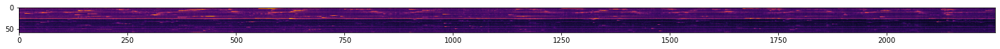

In [84]:
plt.figure(figsize=(25,15))
plt.imshow(nice_cells2,cmap="inferno")

In [135]:
nice_cell_spikes = spikes[np.where(iscell[:,0]==1)]

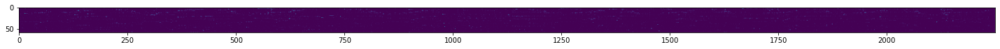

In [92]:
plt.figure(figsize=(25,15))
plt.imshow(nice_cell_spikes,cmap="viridis")

In [90]:
spikes.shape

(447, 2250)

In [91]:
nice_cell_spikes.shape

(58, 2250)

In [93]:
spikes[0]

array([  0.     ,   0.     ,   0.     , ..., 199.96184, 496.66437,
       766.3071 ], dtype=float32)

In [99]:
len(stats[0])

20

In [100]:
stats[0].keys()

dict_keys(['ypix', 'xpix', 'lam', 'med', 'footprint', 'mrs', 'mrs0', 'compact', 'solidity', 'npix', 'npix_soma', 'soma_crop', 'overlap', 'radius', 'aspect_ratio', 'npix_norm_no_crop', 'npix_norm', 'skew', 'std', 'neuropil_mask'])

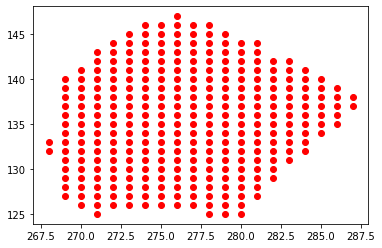

In [115]:
plt.plot(stats[1]["xpix"], stats[1]["ypix"], "ro");

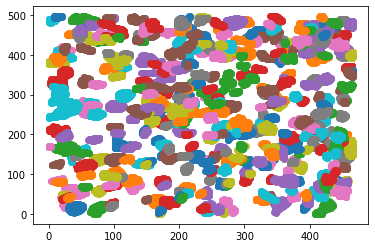

In [117]:
for x in range(0,len(stats)):
    plt.plot(stats[x]["xpix"], stats[x]["ypix"], "o");


In [127]:
@interact(index = IntSlider(value=0, min = 0, max=stats.shape[0]-1))
def plot_spikes(index):
    plt.xlim([0, 550]),plt.ylim([0,550])
    plt.plot(stats[index]["xpix"], stats[index]["ypix"], "s", markersize=10);

interactive(children=(IntSlider(value=0, description='index', max=446), Output()), _dom_classes=('widget-inter…

In [118]:
stats.shape[0]

447

In [104]:
ops.keys()

dict_keys(['look_one_level_down', 'fast_disk', 'delete_bin', 'mesoscan', 'bruker', 'h5py', 'h5py_key', 'save_path0', 'save_folder', 'subfolders', 'move_bin', 'nplanes', 'nchannels', 'functional_chan', 'tau', 'fs', 'force_sktiff', 'frames_include', 'multiplane_parallel', 'ignore_flyback', 'preclassify', 'save_mat', 'save_NWB', 'combined', 'aspect', 'do_bidiphase', 'bidiphase', 'bidi_corrected', 'do_registration', 'two_step_registration', 'keep_movie_raw', 'nimg_init', 'batch_size', 'maxregshift', 'align_by_chan', 'reg_tif', 'reg_tif_chan2', 'subpixel', 'smooth_sigma_time', 'smooth_sigma', 'th_badframes', 'norm_frames', 'force_refImg', 'pad_fft', 'nonrigid', 'block_size', 'snr_thresh', 'maxregshiftNR', '1Preg', 'spatial_hp', 'spatial_hp_reg', 'spatial_hp_detect', 'pre_smooth', 'spatial_taper', 'roidetect', 'spikedetect', 'anatomical_only', 'cellprob_threshold', 'flow_threshold', 'sparse_mode', 'diameter', 'spatial_scale', 'connected', 'nbinned', 'max_iterations', 'threshold_scaling', 'ma

In [108]:
@interact(index=IntSlider(value=0,min=0,max=spikes.shape[0]-1))
def plot_spikes(index):
    plt.plot(spikes[index])

interactive(children=(IntSlider(value=0, description='index', max=446), Output()), _dom_classes=('widget-inter…

In [111]:
@interact(index=IntSlider(value=0,min=0,max=nice_cell_spikes.shape[0]-1))
def plot_spikes(index):
    plt.plot(nice_cell_spikes[index])




interactive(children=(IntSlider(value=0, description='index', max=57), Output()), _dom_classes=('widget-intera…

In [130]:
nice_stats = stats[np.where(iscell[:,0]==1)]

In [133]:
len(nice_stats)

58

In [134]:
@interact(index = IntSlider(value=0, min = 0, max=nice_stats.shape[0]-1))
def plot_spikes(index):
    plt.xlim([0, 550]),plt.ylim([0,550])
    plt.plot(nice_stats[index]["xpix"], nice_stats[index]["ypix"], "s", markersize=10);

interactive(children=(IntSlider(value=0, description='index', max=57), Output()), _dom_classes=('widget-intera…